# Exploratory Data Analysis

## Preparing environment

In [85]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sys
sys.path.append('../high_performance_employee_resign_prediction')
from utils import paths

In [86]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

## Personalizing plots

In [87]:
%matplotlib inline

sns.set_theme(
    style="whitegrid",
    rc = {"figure.figsize": (6, 6)},
    context='notebook'
    )

## Importing data

In [88]:
train_clean_df = pd.read_csv(paths.data_interim_dir('train_clean.csv'))
test_clean_df = pd.read_csv(paths.data_interim_dir('test_clean.csv'))

In [89]:
train_clean_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2152 entries, 0 to 2151
Data columns (total 41 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id_employee_employee          2152 non-null   int64  
 1   id_last_boss_employee         2152 non-null   int64  
 2   seniority_employee            2152 non-null   int64  
 3   work_modality_employee        2152 non-null   object 
 4   office_distance_employee      2152 non-null   float64
 5   low_health_days_employee      2152 non-null   int64  
 6   gender_employee               2152 non-null   object 
 7   recruitment_channel_employee  2152 non-null   object 
 8   average_permanence_employee   2152 non-null   int64  
 9   salary_employee               2152 non-null   int64  
 10  performance_score_employee    2152 non-null   float64
 11  psi_score_employee            2152 non-null   int64  
 12  marital_estatus_employee      2152 non-null   object 
 13  joi

In [90]:
train_clean_df.describe()

,id_employee_employee,id_last_boss_employee,seniority_employee,office_distance_employee,low_health_days_employee,average_permanence_employee,salary_employee,performance_score_employee,psi_score_employee,join_age_employee,...,join_month_boss,office_distance_diff,low_health_days_diff,average_permanence_diff,salary_diff,join_days_diff,joined_after_boss,age_diff,younger_than_boss,resign
count,2152.000000,2152.000000,2152.000000,2152.000000,2152.000000,2152.000000,2.152000e+03,2152.000000,2152.000000,2152.000000,...,2152.000000,2152.000000,2152.000000,2152.000000,2.152000e+03,2152.000000,2152.000000,2152.000000,2152.000000,2152.000000
mean,102070.160781,102090.369424,1.042286,3.111768,2.709108,6.644981,4.570211e+05,63.994424,75.286245,34.981413,...,6.475372,-0.104923,-0.881970,1.632435,9.022575e+05,80.184015,0.474907,-5.500000,0.474907,0.466078
std,1210.999342,43.775341,0.201288,1.789050,2.982975,4.283794,3.029435e+05,22.925485,6.050987,11.101393,...,3.498468,2.487646,3.788334,6.714690,4.917812e+05,1784.648770,0.499486,15.403212,0.499486,0.498964
min,100001.000000,102000.000000,1.000000,0.120000,0.000000,1.000000,7.652100e+04,5.000000,58.000000,9.000000,...,1.000000,-18.980000,-35.000000,-20.000000,-1.210565e+06,-4316.000000,0.000000,-45.000000,0.000000,0.000000
25%,101028.750000,102054.000000,1.000000,1.818750,1.000000,3.000000,2.604398e+05,43.000000,71.000000,27.000000,...,3.000000,-1.460000,-2.000000,-3.000000,6.224485e+05,-1129.250000,0.000000,-16.000000,0.000000,0.000000
50%,102048.500000,102090.500000,1.000000,2.510000,2.000000,6.000000,3.734225e+05,67.000000,75.000000,36.000000,...,6.000000,-0.040000,-1.000000,1.000000,9.754715e+05,91.500000,0.000000,-6.000000,0.000000,0.000000
75%,103135.500000,102127.000000,1.000000,4.151250,3.000000,9.000000,6.741930e+05,89.000000,79.000000,44.000000,...,10.000000,1.261250,1.000000,6.000000,1.309581e+06,1378.000000,1.000000,6.000000,1.000000,1.000000
max,104171.000000,102172.000000,2.000000,21.050000,35.000000,25.000000,1.900000e+06,99.000000,98.000000,65.000000,...,12.000000,6.310000,17.000000,25.000000,1.732943e+06,4056.000000,1.000000,39.000000,1.000000,1.000000


## Exploring variables

### Objective variable: resign

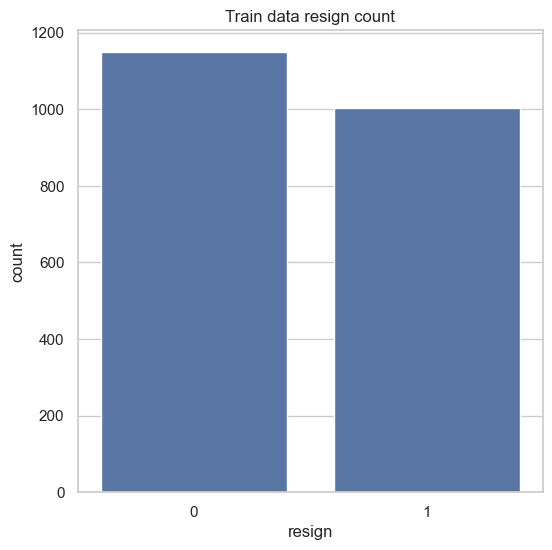

In [91]:
# Plot resign in train data

sns.countplot(data=train_clean_df, x='resign')
plt.title('Train data resign count')

plt.show()

### Categorical columns

In [92]:
cat_cols = train_clean_df.select_dtypes(include='object').columns.tolist()
cat_cols.append('seniority_employee')
cat_cols.append('joined_after_boss')
cat_cols.append('join_month_employee')
cat_cols.append('join_year_employee')
cat_cols.append('join_month_boss')
cat_cols.append('join_year_boss')
cat_cols.append('younger_than_boss')

In [93]:
train_clean_df[cat_cols] = train_clean_df[cat_cols].astype('category')
test_clean_df[cat_cols] = test_clean_df[cat_cols].astype('category')

In [94]:
train_clean_df['resign'] = train_clean_df['resign'].astype('category')

In [95]:
def plotting_categories(df: pd.DataFrame, cat_cols: list, hue=None, name_df = 'Train data'):
    """
    Plot count and proportion distribution of categorical columns in a DataFrame.

    This function generates subplots for each categorical column specified in `cat_cols`.
    Depending on the presence of `hue`, it either plots two subplots (countplot and proportion histogram)
    for each column when `hue` is specified, or just a countplot when `hue` is not specified.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the data to be plotted.
    cat_cols (list): List of column names (strings) containing categorical data to be plotted.
    hue (str, optional): Optional categorical variable for grouping/counting.
    name_df (str, optional): Name of the DataFrame for labeling plots (default is 'Train data').

    Returns:
    None: This function directly plots the graphs using Matplotlib and Seaborn.

    Example:
    >>> import pandas as pd
    >>> import seaborn as sns
    >>> import matplotlib.pyplot as plt
    >>> data = {'category': ['A', 'B', 'A', 'C', 'B', 'A'], 'value': [1, 2, 3, 1, 2, 3]}
    >>> df = pd.DataFrame(data)
    >>> plotting_categories(df, ['category'])
    """
    if hue:
        fig, axs = plt.subplots(len(cat_cols), 2, figsize=(12, 6*len(cat_cols)))
        for i, col in enumerate(cat_cols):
            sns.countplot(data=df, x=col, hue=hue, ax=axs[i, 0])
            sns.histplot(data=df, x=col, hue=hue, multiple='fill', stat='proportion', shrink=.8, ax=axs[i, 1])

            axs[i, 0].set_title(f'{name_df} {col} count by {hue}')
            axs[i, 1].set_title(f'{name_df} {col} proportion by {hue}')


    else:
        fig, axs = plt.subplots(len(cat_cols), 1, figsize=(6, 6*len(cat_cols)))
        for i, col in enumerate(cat_cols):
            sns.countplot(data=df, x=col, ax=axs[i])
            axs[i].set_title(f'{name_df} {col} count')
    
    plt.tight_layout()

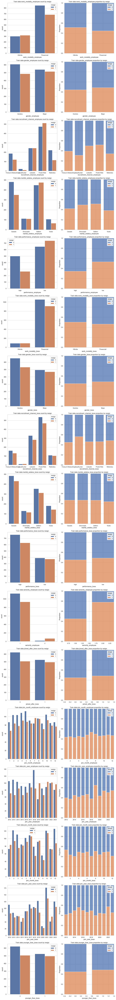

In [96]:
# Plot category on train data (except id_last_boss due to category quantity)

plotting_categories(train_clean_df, cat_cols, hue='resign')

plt.show()

Analizing plots, there are some observations:

- Employees with people in charge are widely more likely to resign the first 6 months; maybe their work load is much higher.
- Hybrid work modality employees are sightly more likely to resign the first 6 months, this will be tested with hypothesis testing.
- There are no great differences between gender on resign the first 6 months, but women are sightly more likely to resign. This will be tested with hypothesis testing.
- Employees recruited by LinkedIn and Portal Web are significantly more likely to resign the first 6 months than recruited by other methods. It's important to ensure that work conditions and remuneration are well defined on those methods to avoid a bad experience for new employees. This will be tested with hypothesis testing.
- Divorced and single employees are more likely to resign on the first 6 months. This will be tested with hypothesis testing.
- Employees are sightly more likely to resign on the second semester of the year, specially those that were recruited on july and august. This can be a signal that work load increases significantly on those dates and employees look to resign. This will be tested with hypothesis testing.
- Low performance employees are widely more likely to resign.
- People that joined the latests years from 2019 are more likely to resign
- Boss work modality don't seems to have effects on resign. This will be tested with hypothesis testing
- People with woman boss are sightly more likely to resign
- People with boss recruited by headhunter are sightly more likely to resign. Will be tested with hypothesis testing.
- There are differences in resign in the year that boss joined
- Most of the bosses have low performance, and people who have low performance bosses are sightly more likely to resign
- join_month and join_year for both employee and boss will be tested with hypothesis testing to determine if they have influence over the resign
- People younger than boss are more likely to resign

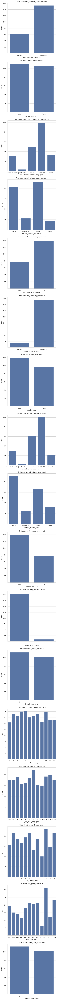

In [97]:
plotting_categories(train_clean_df, cat_cols)

plt.show()

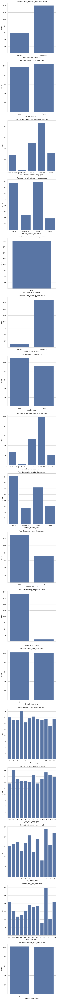

In [98]:
plotting_categories(test_clean_df, cat_cols, name_df='Test data')

plt.show()

# Exploring bosses with the most higher employee resign proportion

In [99]:
# Counting exployees who resign by boss

boss_resign_count = train_clean_df.groupby('id_last_boss_employee')['resign'].value_counts().unstack().sort_values(by=1, ascending=False)
boss_resign_count

resign,0,1
id_last_boss_employee,,
102172,16,20
102120,6,18
102171,17,17
102043,7,16
102138,7,16
...,...,...
102148,2,0
102023,13,0
102053,7,0


In [100]:
# Calculating proportion of employees who resing by boss

boss_resign_proportion = train_clean_df.groupby('id_last_boss_employee')['resign'].value_counts(normalize=True).unstack().sort_values(by=1, ascending=False)
boss_resign_proportion

resign,0,1
id_last_boss_employee,,
102167,0.000000,1.000000
102166,0.000000,1.000000
102125,0.153846,0.846154
102127,0.187500,0.812500
102062,0.222222,0.777778
...,...,...
102023,1.000000,0.000000
102004,1.000000,0.000000
102003,1.000000,0.000000


In [101]:
# Joining both tables

joined_boss = boss_resign_proportion.merge(boss_resign_count, on='id_last_boss_employee', how='inner')
joined_boss['total_employees'] = joined_boss['0_y'] + joined_boss['1_y']
joined_boss = joined_boss.sort_values(by=['1_x', 'total_employees'], ascending=[False, False])
joined_boss

resign,0_x,1_x,0_y,1_y,total_employees
id_last_boss_employee,,,,,
102166,0.000000,1.000000,0,2,2
102167,0.000000,1.000000,0,1,1
102125,0.153846,0.846154,2,11,13
102127,0.187500,0.812500,3,13,16
102062,0.222222,0.777778,2,7,9
...,...,...,...,...,...
102163,1.000000,0.000000,1,0,1
102164,1.000000,0.000000,1,0,1
102004,1.000000,0.000000,1,0,1


In [102]:
joined_boss.head(20)

resign,0_x,1_x,0_y,1_y,total_employees
id_last_boss_employee,,,,,
102166,0.000000,1.000000,0,2,2
102167,0.000000,1.000000,0,1,1
102125,0.153846,0.846154,2,11,13
102127,0.187500,0.812500,3,13,16
102062,0.222222,0.777778,2,7,9
102158,0.222222,0.777778,2,7,9
102120,0.250000,0.750000,6,18,24
102013,0.250000,0.750000,2,6,8
102093,0.266667,0.733333,4,11,15


In [103]:
joined_boss.index = joined_boss.index.astype('category')

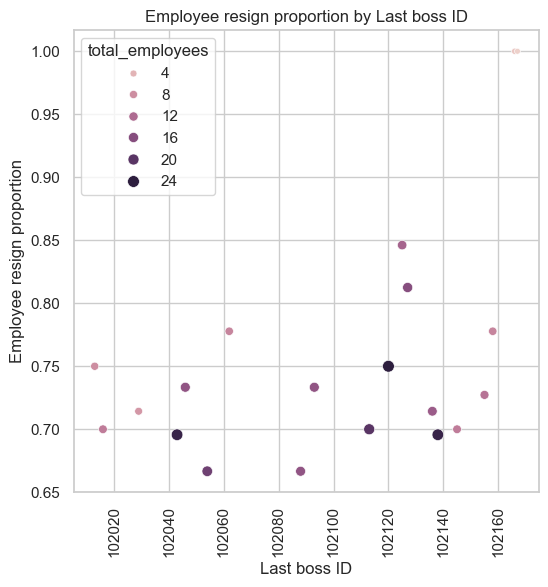

In [104]:
# Plotting the bosses with the highest proportion of employees resign

sns.scatterplot(data=joined_boss.head(20), x='id_last_boss_employee', y='1_x', size='total_employees', hue='total_employees')
plt.xlabel('Last boss ID')
plt.ylabel('Employee resign proportion')
plt.title('Employee resign proportion by Last boss ID')
plt.xticks(rotation=90)
plt.show()

As we can see from the plot and the table, `id_ultimo_jefe` could have great influence in the resign, which means that some people are more likely to resign if they have certain bosses. In the business context, it is important to check the reasons from each boss and apply corrective actions in order to reduce people resign.

## Exploring numerical columns

In [105]:
num_cols = train_clean_df.select_dtypes(include='number').columns.tolist()
num_cols.remove('id_employee_employee')
num_cols.remove('id_last_boss_employee')
num_cols.remove('id_last_boss_boss')

In [106]:
def explore_numerical_dist(df: pd.DataFrame, cols: list, hue=None, name_df='Train data'):
    """
    Visualize the distribution of numerical columns in a DataFrame using histograms and boxplots.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the data.
    cols (list): List of numerical columns to visualize.
    hue (str, optional): Column name to use for color coding in the plots. Defaults to None.
    df_name (str, optional): Name of the DataFrame to include in plot titles. Defaults to 'Train data'.

    Returns:
    None: The function creates and displays the plots.

    """
    
    fig, axs = plt.subplots(len(cols), 2, figsize=(12, 6*len(cols)))

    if hue:
        for i, col in enumerate(cols):
            sns.histplot(data=df, x=col, hue=hue, ax=axs[i, 0], kde=True)
            sns.boxplot(data=df, x=col, hue=hue, ax=axs[i, 1])

            axs[i, 0].set_title(f'{name_df} {col} histogram by {hue}')
            axs[i, 1].set_title(f'{name_df} {col} boxplot by {hue}')

    else:
        for i, col in enumerate(cols):
            sns.histplot(data=df, x=col, ax=axs[i, 0], kde=True)
            sns.boxplot(data=df, x=col, ax=axs[i, 1])

            axs[i, 0].set_title(f'{name_df} {col} histogram')
            axs[i, 1].set_title(f'{name_df} {col} boxplot')
    
    plt.tight_layout()

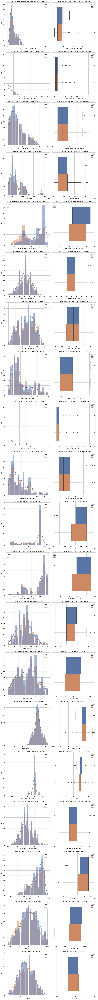

In [107]:
explore_numerical_dist(train_clean_df, num_cols, hue='resign')

plt.show()

In general, distribution for both employees who resigned and those who don't are similar, except for performance_score, where people with lower performance score are sightly more likely to resing.

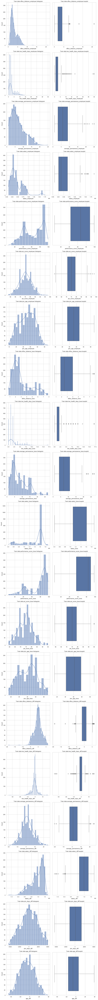

In [108]:
explore_numerical_dist(train_clean_df, num_cols)

plt.show()

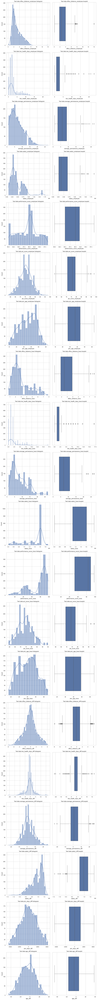

In [109]:
explore_numerical_dist(test_clean_df, num_cols, name_df='Test data')

plt.show()

Analysing distributions for both test and train data, we can see that they are similar.

The outliers are natural variations of the population, for example: In `salary` it is normal a great salary that could be from a CEO or someone who have a lot of people in charged, or in `low_health_days` there are people that were sick for many days.

Additionally, we can see skewed distributions, which lead us to make the analysis using the median.

## Bivariate analysis

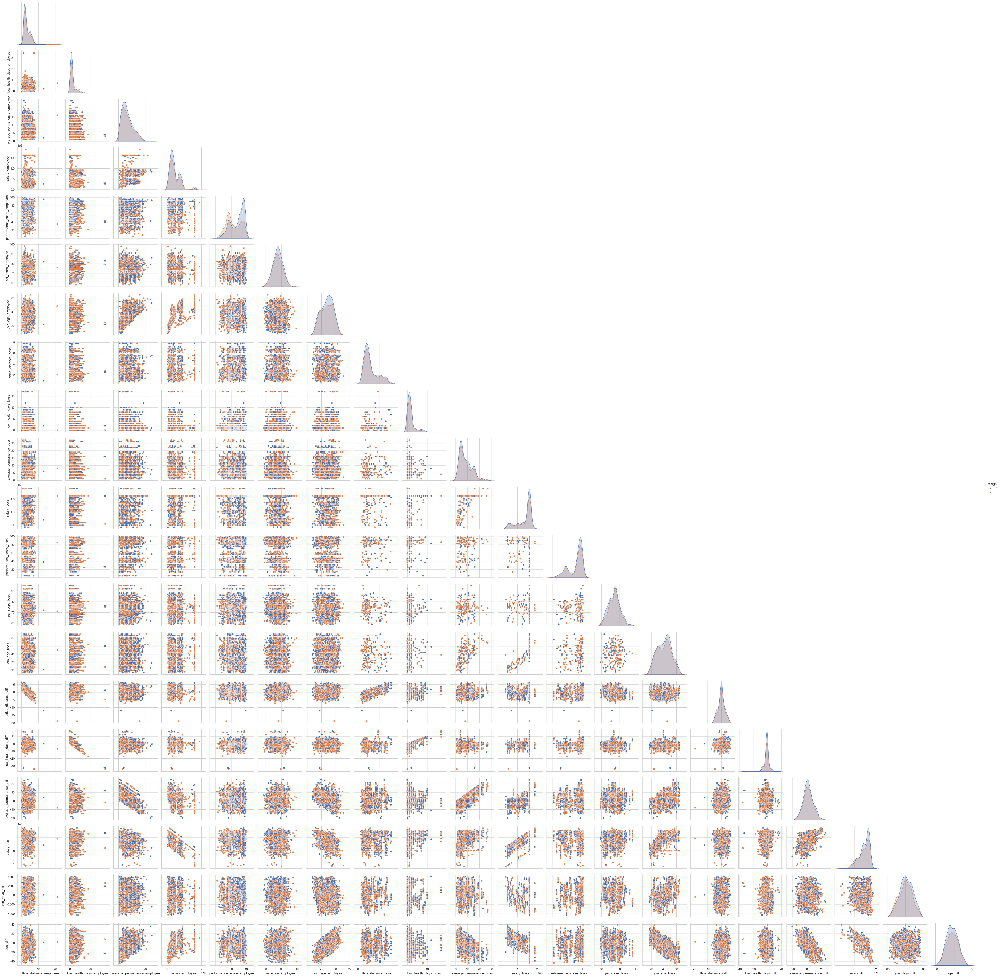

In [122]:
sns.pairplot(data=train_clean_df.drop(columns=['id_employee_employee', 'id_last_boss_employee', 'id_last_boss_boss']), hue='resign', corner=True)

plt.savefig('pairplot_resign.jpg')
plt.show()

In general, there are no observable relationships between the variables and the resing, and distributions are similar,except for perfomance_score

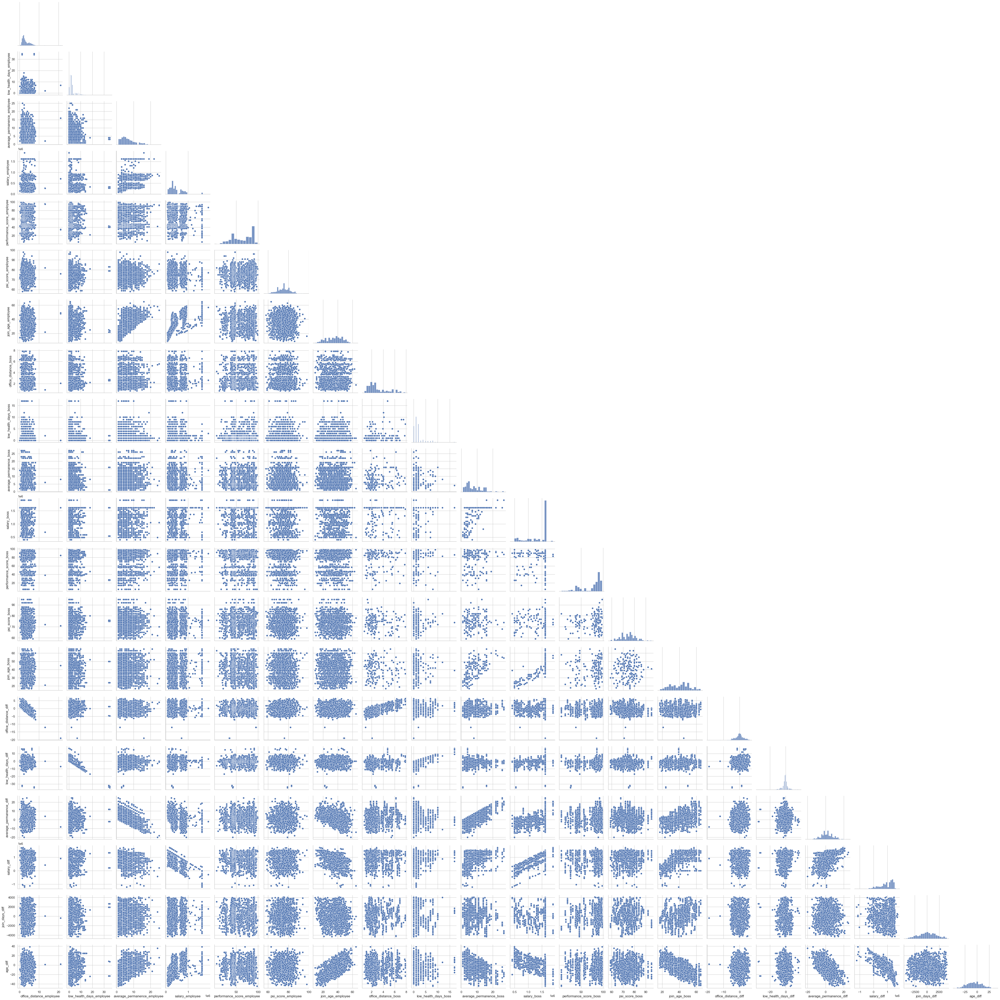

In [117]:
sns.pairplot(data=train_clean_df.drop(columns=['id_employee_employee', 'id_last_boss_employee', 'id_last_boss_boss']), corner=True)

plt.show()

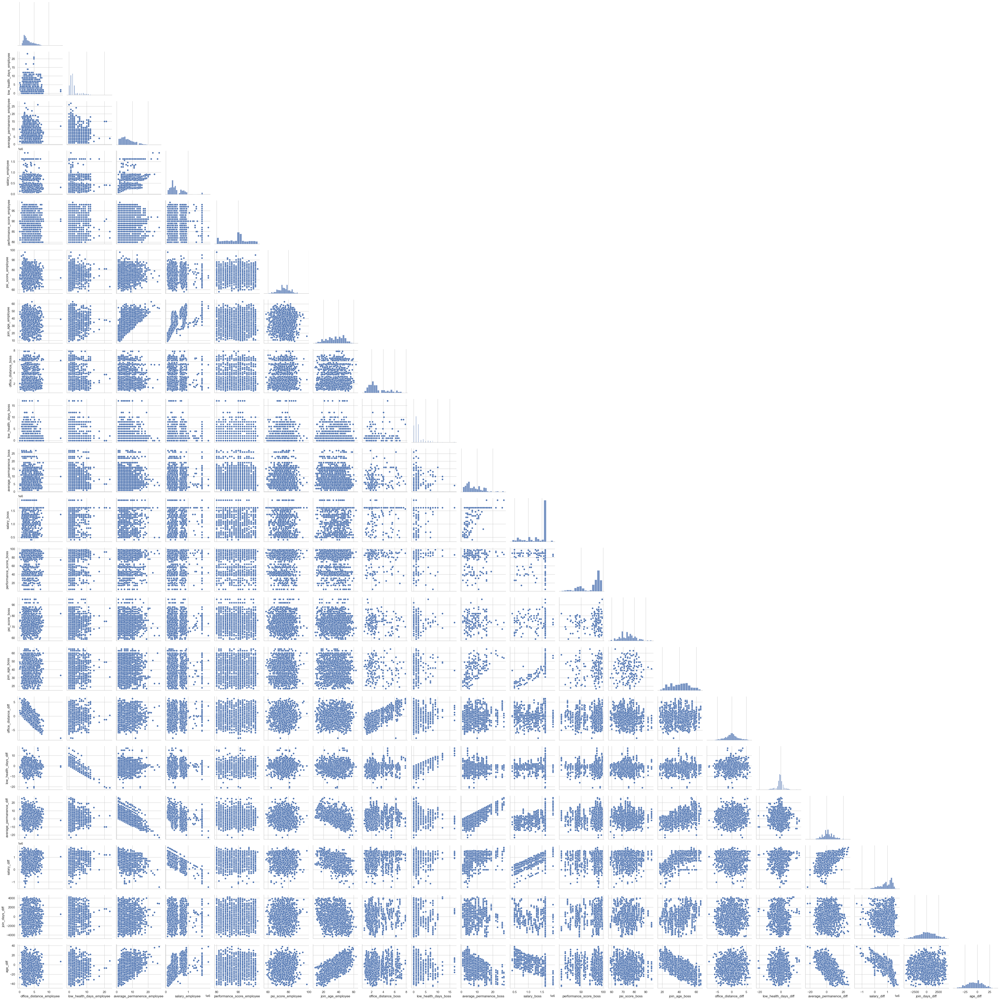

In [118]:
sns.pairplot(data=test_clean_df.drop(columns=['id_employee_employee', 'id_last_boss_employee', 'id_last_boss_boss']), corner=True)

plt.show()

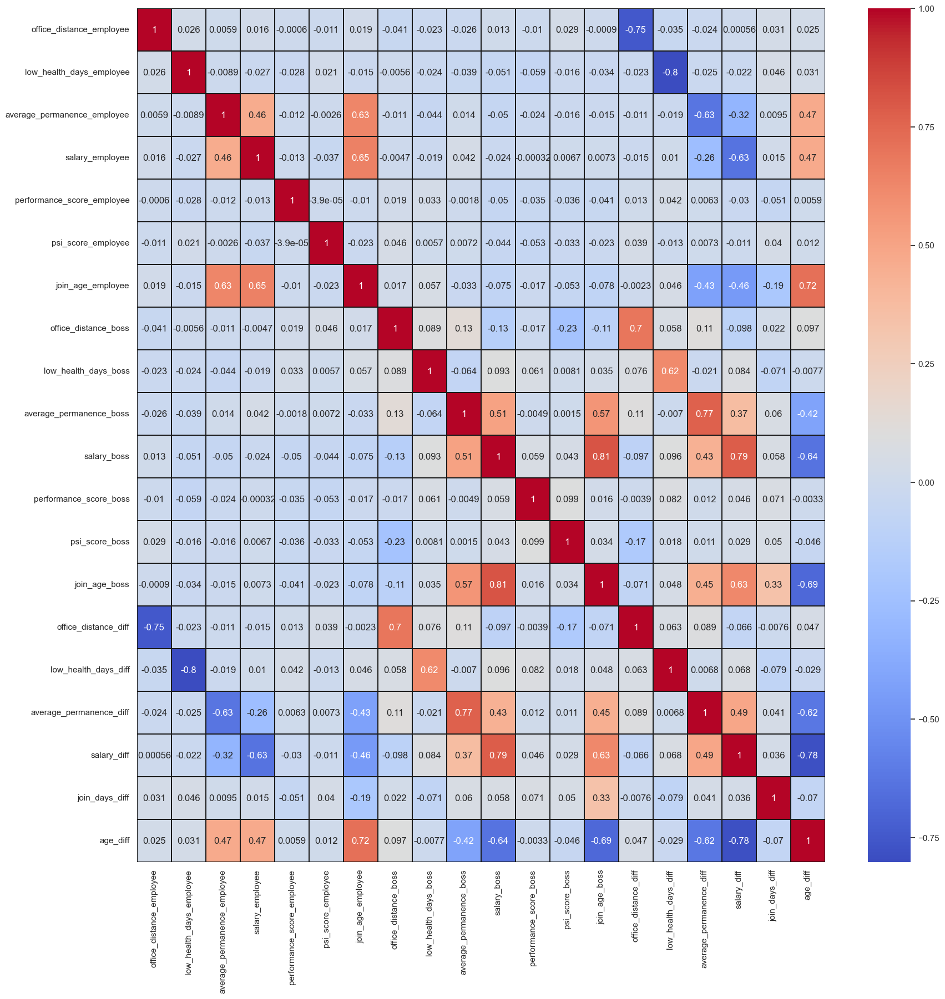

In [119]:
plt.figure(figsize=(20, 20))
sns.heatmap(data=train_clean_df[num_cols].corr(), cmap='coolwarm', linecolor='k', linewidths=0.1, annot=True)
plt.savefig('train_data_num')
plt.show()

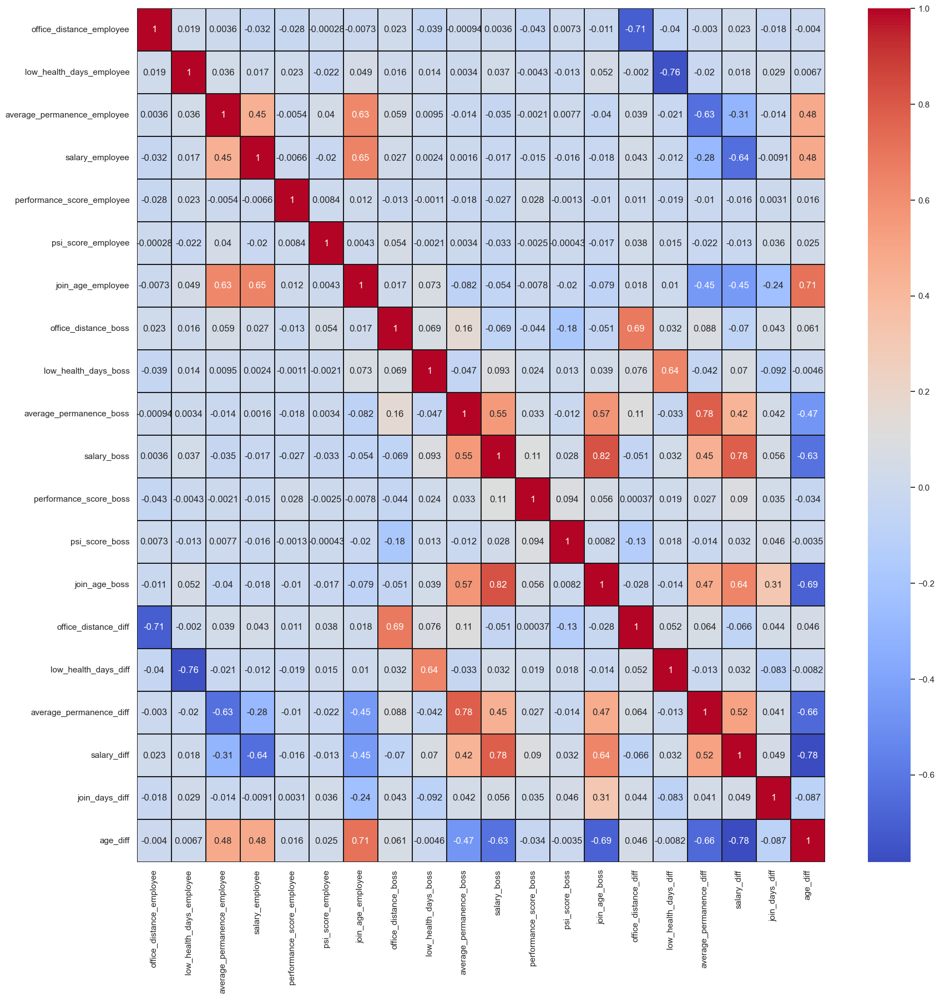

In [120]:
plt.figure(figsize=(20, 20))
sns.heatmap(data=test_clean_df[num_cols].corr(), cmap='coolwarm', linecolor='k', linewidths=0.1, annot=True)
plt.show()

There is a moderate positive relationship between salario-permanencia_promedio, and a high correlation between age-permanencia_promedio and age-salario.

In [124]:
# Checking median of the numerical columns between the people who resign and who don't

train_clean_df.groupby('resign')[num_cols].median()

,office_distance_employee,low_health_days_employee,average_permanence_employee,salary_employee,performance_score_employee,psi_score_employee,join_age_employee,office_distance_boss,low_health_days_boss,average_permanence_boss,salary_boss,performance_score_boss,psi_score_boss,join_age_boss,office_distance_diff,low_health_days_diff,average_permanence_diff,salary_diff,join_days_diff,age_diff
resign,,,,,,,,,,,,,,,,,,,,
0,2.505,2.0,6.0,373470.0,77.0,75.0,36.0,2.48,1.0,7.0,1616000.0,84.0,75.0,41.0,-0.055,0.0,1.0,1043336.0,189.0,-6.0
1,2.510,2.0,6.0,373293.0,54.0,75.0,36.0,2.50,1.0,7.0,1616000.0,84.0,75.0,41.0,-0.025,-1.0,1.0,957902.0,13.0,-5.0


Signifficant differences only on performance_score_employee, salary_diff and join_days_diff

In [125]:
# Checking median of the numerical columns between the people who resign and who don't

train_clean_df.groupby('resign')[num_cols].mean()

,office_distance_employee,low_health_days_employee,average_permanence_employee,salary_employee,performance_score_employee,psi_score_employee,join_age_employee,office_distance_boss,low_health_days_boss,average_permanence_boss,salary_boss,performance_score_boss,psi_score_boss,join_age_boss,office_distance_diff,low_health_days_diff,average_permanence_diff,salary_diff,join_days_diff,age_diff
resign,,,,,,,,,,,,,,,,,,,,
0,3.112515,2.328982,6.703220,441639.556136,69.926023,75.339426,34.906005,3.016754,1.811140,8.368146,1.372516e+06,74.798956,74.385553,40.468233,-0.095762,-0.517842,1.664926,930876.666667,194.084421,-5.557006
1,3.110912,3.144566,6.578265,474641.733799,57.199402,75.225324,35.067797,2.995494,1.845464,8.173480,1.344114e+06,72.569292,74.492522,39.830508,-0.115419,-1.299103,1.595214,869472.468594,-50.296112,-5.434696


Signifficant differences on low_health_days_employee, performance_score_employee, salary_diff and join_days_diff. All the columns will be tested with hypothesis testing